<a href="https://colab.research.google.com/github/mukul-B/ForestFIre/blob/master/exploringVIIRS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
import geopandas as gpd
import matplotlib.pyplot as plt

In [3]:
!pip install geopandas

     |████████████████████████████████| 1.0 MB 7.7 MB/s 
     |████████████████████████████████| 6.3 MB 46.0 MB/s 
     |████████████████████████████████| 16.7 MB 43.7 MB/s 


In [6]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [60]:
gdf = gpd.read_file('/content/drive/MyDrive/Wildfire/DL_FIRE_SV-C2_270448/fire_archive_SV-C2_270448.shp')

In [57]:
print(gdf.head())

      LATITUDE   LONGITUDE  BRIGHTNESS  SCAN  TRACK    ACQ_DATE ACQ_TIME  \
551  38.744495 -120.433586       367.0  0.38   0.36  2021-08-18     0954   
635  38.756420 -120.444130       367.0  0.38   0.36  2021-08-18     0954   
659  46.825863 -121.030853       367.0  0.42   0.38  2021-08-18     0954   
734  38.740520 -120.430077       367.0  0.38   0.36  2021-08-18     0954   
745  40.329300 -122.873344       367.0  0.42   0.37  2021-08-18     0954   

    SATELLITE INSTRUMENT CONFIDENCE VERSION  BRIGHT_T31    FRP DAYNIGHT  TYPE  \
551         N      VIIRS          h       1      339.60  49.08        N     0   
635         N      VIIRS          h       1      308.36  22.07        N     0   
659         N      VIIRS          h       1      341.26  81.24        N     0   
734         N      VIIRS          h       1      336.28  35.22        N     0   
745         N      VIIRS          h       1      297.66   6.15        N     0   

                        geometry  
551  POINT (-120.4335

In [55]:
gdf = gdf[gdf['CONFIDENCE'] != 'n']

In [46]:
gdf = gdf[gdf['CONFIDENCE'] > 50]

TypeError: ignored

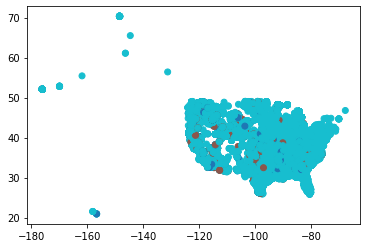

In [66]:
gdf.plot(column='CONFIDENCE')
plt.show()

In [9]:
!pip install show mapboxgl

     |████████████████████████████████| 44 kB 1.8 MB/s 
     |████████████████████████████████| 43 kB 1.6 MB/s 
     |████████████████████████████████| 2.3 MB 16.2 MB/s 
  Created wheel for chroma-py: filename=chroma_py-0.1.0.dev1-py3-none-any.whl size=5118 sha256=2aa84bfd22048a33abc96b9750b3111b9d3178228649962c40e59ed6000b45de
  Stored in directory: /root/.cache/pip/wheels/11/39/14/aad37133f36231c513ab6699bd3817cf58a8a3e6a2db4e19b7
  Created wheel for readline: filename=readline-6.2.4.1-cp37-cp37m-linux_x86_64.whl size=348802 sha256=acabdb626c2db13c6bc43030b64bdb4c6790d4703cc8a8032a2052fe966c655b
  Stored in directory: /root/.cache/pip/wheels/18/d3/d3/61126fca6a9fe8050aa6cb085d3e59516744caa9d905467c0d
Successfully built chroma-py readline
  Attempting uninstall: six
    Found existing installation: six 1.15.0
    Uninstalling six-1.15.0:
      Successfully uninstalled six-1.15.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. 

In [25]:
from mapboxgl.utils import create_color_stops,df_to_geojson,gdf_to_geojson
from mapboxgl.viz import CircleViz

In [68]:
color_break= [0,300,350,400]
color_stops= create_color_stops(color_break,colors='YlOrRd')

In [12]:
token='pk.eyJ1IjoibXVrdWxiIiwiYSI6ImNsMzhkNnJsaTAwZHgza3FvM3Y1aXZnZGUifQ.ApCP6kzIZ7pNGCYLbUX78g'

In [69]:
viz =CircleViz(gdf_to_geojson(gdf,properties=['CONFIDENCE','BRIGHTNESS']),
               access_token=token,
               color_property='BRIGHTNESS',
               color_stops=color_stops)

In [70]:
viz.show()

In [67]:
import seaborn as sns
sns.heatmap(gdf['CONFIDENCE'][:])

IndexError: ignored